# Face Detection and Emotion Recognition with Deep Learning



## Part 1: Face Detection with Detectron2

### Detectron2 - Introduction

Detectron2 is Facebook AI Research's next generation software system that implements state-of-the-art object detection algorithms. It is a ground-up rewrite of the previous version, Detectron, and it originates from maskrcnn-benchmark. This library is powered by the PyTorch deep learning framework and includes more features such as panoptic segmentation, Densepose, Cascade R-CNN, rotated bounding boxes, PointRend, DeepLab, etc. Furthermore, it trains much faster.

### Face Detection
Face detection posed several challenges in the past. The method of face detection in pictures is complicated because of variability present across human faces such as pose, expression, position and orientation, skin colour, the presence of glasses or facial hair, differences in camera gain, lighting conditions, and image resolution.

Generally speaking, face detection is about locating and localizing one or more faces in a photograph. Locating a face in a photograph refers to finding the coordinate of the face in the image, whereas localization refers to demarcating the extent of the face, often via a bounding box around the face.

Part 1 of this notebook borrows heavily (with modification) from the Detectron2 Beginner's Tutorial from Facebook (https://colab.research.google.com/drive/16jcaJoc6bCFAQ96jDe2HwtXj7BMD_-m5) and this Medium article (https://towardsdatascience.com/face-detection-on-custom-dataset-with-detectron2-and-pytorch-using-python-23c17e99e162)

### Part 1.1: Set up


In [ ]:
#Let's see what we got with the Pro Google Colab version!
#Look like we got a Tesla  V100. Tesla V100 is the fastest NVIDIA GPU available on the market. V100 is 3x faster than P100.
!nvidia-smi

Tue Dec  8 02:00:04 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 455.45.01    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla V100-SXM2...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   34C    P0    24W / 300W |      0MiB / 16130MiB |      0%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
!pip install -q cython pyyaml==5.3
!pip install -q -U 'git+https://github.com/cocodataset/cocoapi.git#subdirectory=PythonAPI'

ERROR: detectron2 0.3 has requirement pycocotools>=2.0.2, but you'll have pycocotools 2.0 which is incompatible.


In [ ]:
#you will have to restart run time after running this block for the first time
!git clone https://github.com/facebookresearch/detectron2 detectron2_repo
!pip install -q -e detectron2_repo

fatal: destination path 'detectron2_repo' already exists and is not an empty directory.


In [ ]:
#An IPython magic extension for printing date and time stamps, version numbers, and hardware information.
!pip install -q -U watermark

In [ ]:
%reload_ext watermark
%watermark -v -p numpy,pandas,pycocotools,torch,torchvision,detectron2

CPython 3.6.9
IPython 5.5.0

numpy 1.18.5
pandas 1.1.4
pycocotools 2.0.2
torch 1.7.0+cu101
torchvision 0.8.1+cu101
detectron2 0.3


In [ ]:
#PyTorch and related libraries
import torch, torchvision
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor, DefaultTrainer
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer, ColorMode
from detectron2.data import datasets, DatasetCatalog, MetadataCatalog, build_detection_train_loader, build_detection_test_loader
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.structures import BoxMode
import cv2

#Data preprocessing
import urllib
import json

#Data wrangling and visualization
import numpy as np
import pandas as pd
import seaborn as sns
from pylab import rcParams
import matplotlib.pyplot as plt
from matplotlib import rc
%matplotlib inline

#view images
import PIL.Image as Image

#Misc
import os
import ntpath
import random
import itertools
from tqdm import tqdm
from google.colab.patches import cv2_imshow

%config InlineBackend.figure_format='retina'

rcParams['figure.figsize'] = 14, 10

RANDOM_SEED = 42
np.random.seed(RANDOM_SEED)
torch.manual_seed(RANDOM_SEED)

### Part 1.2: Data Pre-processing and Visualization

We need to download the data from Dataturks. The data is available as a JSON file with 2 main components, an URL address of the image, and the face labels and bounding boxes of that image. We will then need to extract those information from the JSON file, make an annotate function, and show the images with the correct bounding boxes for the faces in that image.

In [ ]:
#Download data from Dataturks
!gdown --id 1K79wJgmPTWamqb04Op2GxW0SW9oxw8KS

Downloading...
From: https://drive.google.com/uc?id=1K79wJgmPTWamqb04Op2GxW0SW9oxw8KS
To: /content/face_detection.json
100% 274k/274k [00:00<00:00, 101MB/s]


In [ ]:
#Read the JSON file
faces_df = pd.read_json('face_detection.json', lines=True)
faces_df.head()

,content,annotation,extras
0,http://com.dataturks.a96-i23.open.s3.amazonaws...,"[{'label': ['Face'], 'notes': '', 'points': [{...",NaN
1,http://com.dataturks.a96-i23.open.s3.amazonaws...,"[{'label': ['Face'], 'notes': '', 'points': [{...",NaN
2,http://com.dataturks.a96-i23.open.s3.amazonaws...,"[{'label': ['Face'], 'notes': '', 'points': [{...",NaN
3,http://com.dataturks.a96-i23.open.s3.amazonaws...,"[{'label': ['Face'], 'notes': '', 'points': [{...",NaN
4,http://com.dataturks.a96-i23.open.s3.amazonaws...,"[{'label': ['Face'], 'notes': '', 'points': [{...",NaN


We need to extract the labels and bounding boxes from the "annotation" column. We then save the images stored at the URLs from the dataframe above so we can use them later to train our model.

In [ ]:
os.makedirs("faces", exist_ok=True)

faces_set = []

for index, row in tqdm(faces_df.iterrows(), total=faces_df.shape[0]):
    img = urllib.request.urlopen(row["content"])
    img = Image.open(img)
    img = img.convert('RGB')

    image_name = f'face_{index}.jpeg'

    img.save(f'faces/{image_name}', "JPEG")
    
    annotations = row['annotation']
    for value in annotations:

      data = {}

      width = value['imageWidth']
      height = value['imageHeight']
      points = value['points']

      data['file_name'] = image_name
      data['width'] = width
      data['height'] = height

      data["x_min"] = int(round(points[0]["x"] * width))
      data["y_min"] = int(round(points[0]["y"] * height))
      data["x_max"] = int(round(points[1]["x"] * width))
      data["y_max"] = int(round(points[1]["y"] * height))

      data['class_name'] = 'face'

      faces_set.append(data)
    

100%|██████████| 409/409 [03:35<00:00,  1.90it/s]


After extracting the face labels and the bounding boxes for each face in each picture, we turn that into a dataframe.

In [ ]:
faces_df_clean = pd.DataFrame(faces_set)
faces_df_clean.head()

,file_name,width,height,x_min,y_min,x_max,y_max,class_name
0,face_0.jpeg,650,333,56,102,112,151,face
1,face_0.jpeg,650,333,379,97,428,156,face
2,face_1.jpeg,1280,697,903,162,985,252,face
3,face_2.jpeg,460,240,216,12,279,80,face
4,face_2.jpeg,460,240,289,2,343,74,face


In [ ]:
print('Number of images we have: ', faces_df_clean['file_name'].unique().shape[0])
print('Number of faces we have: ', faces_df_clean.shape[0])

Number of images we have:  409
Number of faces we have:  1132


It looks like we have about 400 images with a bit more than 1000 faces to train on. In practice, this amount of data is rather small but given the scope of the project and limitation in training time, the dataset works well. 

In [ ]:
#save the dataframe to csv file to work on later
faces_df_clean.to_csv('annotations.csv', header=True, index=None)

In [ ]:
#Create an annotate function to show the bounding boxes for each picture
def annotate_image(annotations, resize=True):
  file_name = annotations['file_name'].to_numpy()[0]
  img = cv2.cvtColor(cv2.imread(f'faces/{file_name}'), cv2.COLOR_BGR2RGB)

  for i, a in annotations.iterrows():    
    cv2.rectangle(img, (a.x_min, a.y_min), (a.x_max, a.y_max), (0, 255, 0), 2)

  if not resize:
    return img

  return cv2.resize(img, (384, 384), interpolation = cv2.INTER_AREA)

Let's take a look at some examples from the dataset!

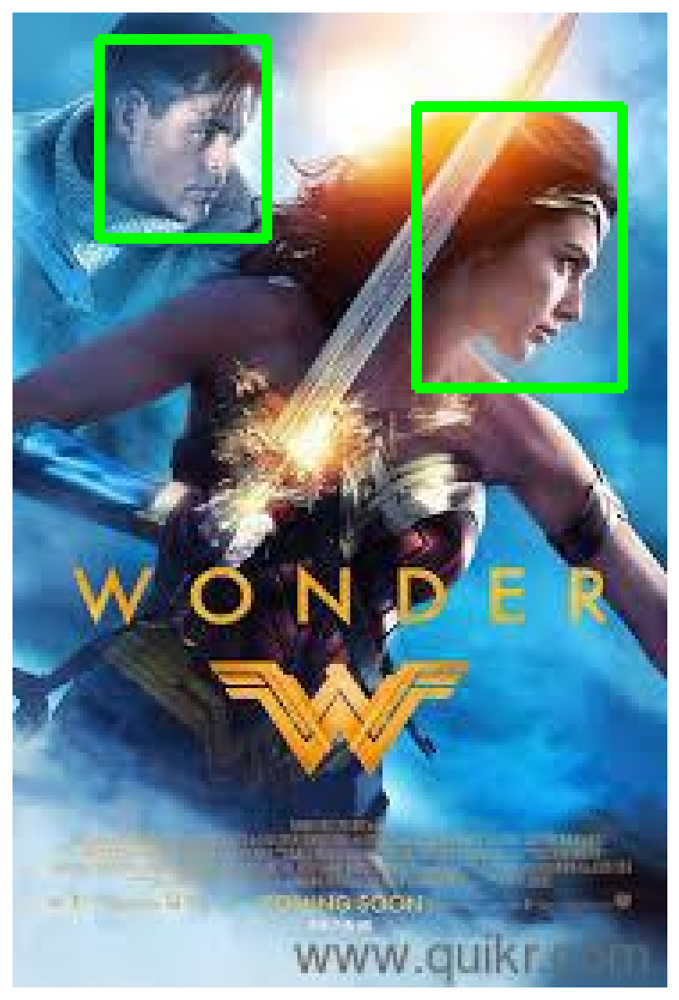

In [ ]:
img_df = faces_df_clean[faces_df_clean['file_name'] == faces_df_clean['file_name'].unique()[9]]
img = annotate_image(img_df, resize=False)

plt.imshow(img)
plt.axis('off');

Let's show a few more images!

In [ ]:
sample_images = [annotate_image(faces_df_clean[faces_df_clean['file_name'] == i]) for i in faces_df_clean['file_name'].unique()[100:110]]
sample_images = torch.as_tensor(sample_images)
sample_images.shape

torch.Size([10, 384, 384, 3])

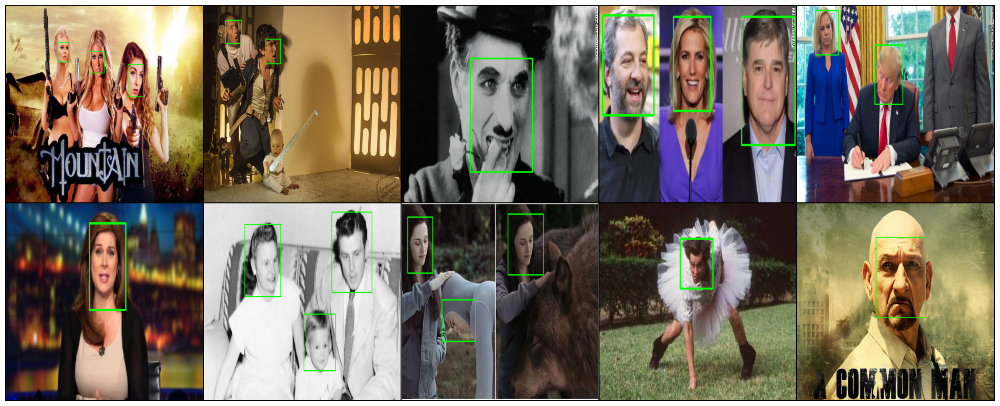

In [ ]:
#createa a grid of images
sample_images = sample_images.permute(0, 3, 1, 2)

plt.figure(figsize=(24, 12))
grid_img = torchvision.utils.make_grid(sample_images, nrow=5)

plt.imshow(grid_img.permute(1, 2, 0))
plt.axis('off');

### Part 1.3: Prepare the Dataset



In [ ]:
#Randomly select 90% of the images we have (out of 409) to train
df = pd.read_csv('annotations.csv')

#create a folder to save the faces
image_path = f'faces'

unique_files = df.file_name.unique()

#the train-test-split function would not work here due to multiple faces in each image
train_files = set(np.random.choice(unique_files, int(len(unique_files) * 0.90), replace=False))
train_df = df[df.file_name.isin(train_files)]
test_df = df[~df.file_name.isin(train_files)]

train_df.head()

,file_name,width,height,x_min,y_min,x_max,y_max,class_name
0,face_0.jpeg,650,333,56,102,112,151,face
1,face_0.jpeg,650,333,379,97,428,156,face
2,face_1.jpeg,1280,697,903,162,985,252,face
3,face_2.jpeg,460,240,216,12,279,80,face
4,face_2.jpeg,460,240,289,2,343,74,face


In [ ]:
print('Training example: ', train_df.shape)
print('Testing example: ', test_df.shape)

Training example:  (1014, 8)
Testing example:  (118, 8)


In [ ]:
classes = df.class_name.unique().tolist()

We need to convert the dataframe to a format that Detectron2 could work with.

In [ ]:
# if your dataset is in COCO format, this cell can be replaced by the following three lines:
# from detectron2.data.datasets import register_coco_instances
# register_coco_instances("my_dataset_train", {}, "json_annotation_train.json", "path/to/image/dir")
# register_coco_instances("my_dataset_val", {}, "json_annotation_val.json", "path/to/image/dir")

def create_dataset_dicts(df, classes):
  dataset = []
  for image_id, img_name in enumerate(df.file_name.unique()):

    record = {} # each record contains the coordinate of the bounding box, segmentation and the class ID (index of the class)

    image_df = df[df.file_name == img_name] #take in all the faces in EACH image

    file_path = f'{image_path}/{img_name}'
    record["file_name"] = file_path
    record["image_id"] = image_id
    record["height"] = int(image_df.iloc[0].height)
    record["width"] = int(image_df.iloc[0].width)

    objects = []
    for i, row in image_df.iterrows():

      xmin = int(row.x_min)
      ymin = int(row.y_min)
      xmax = int(row.x_max)
      ymax = int(row.y_max)

      #define the bounding box
      poly = [
          (xmin, ymin), (xmax, ymin), 
          (xmax, ymax), (xmin, ymax)
      ]
      poly = list(itertools.chain.from_iterable(poly))

      obj = {
        "bbox": [xmin, ymin, xmax, ymax],
        "bbox_mode": BoxMode.XYXY_ABS,
        "segmentation": [poly],
        "category_id": classes.index(row.class_name),
        "iscrowd": 0
      }
      objects.append(obj)

    record["annotations"] = objects
    dataset.append(record)
  return dataset

In [ ]:
#register the dataset
for img in ["train", "val"]:
  DatasetCatalog.register("faces_" + img, lambda img=img: create_dataset_dicts(train_df if img == "train" else test_df, classes))
  MetadataCatalog.get("faces_" + img).set(thing_classes=classes)

statement_metadata = MetadataCatalog.get("faces_train")

### Part 1.4: Train the Model

In [ ]:
#create our customized trainer
class CocoTrainer(DefaultTrainer):
  
  @classmethod
  def build_evaluator(cls, cfg, dataset_name, output_folder=None):

    if output_folder is None:
        os.makedirs("coco_eval", exist_ok=True)
        output_folder = "coco_eval"

    return COCOEvaluator(dataset_name, cfg, False, output_folder)

In [ ]:
#download the pre-trained model from the model zoo
#we use X101-FPN Mask R-CNN with best box AP but the downside is that it takes a lot of time to train

cfg = get_cfg()

cfg.merge_from_file(
  model_zoo.get_config_file(
    "COCO-InstanceSegmentation/mask_rcnn_X_101_32x8d_FPN_3x.yaml"
  )
)

cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url(
  "COCO-InstanceSegmentation/mask_rcnn_X_101_32x8d_FPN_3x.yaml"
)

You can read more about the configuration for Detectron2 here: https://detectron2.readthedocs.io/modules/config.html

In [ ]:
cfg.DATASETS.TRAIN = ("faces_train",)
cfg.DATASETS.TEST = ("faces_val",)
cfg.DATALOADER.NUM_WORKERS = 4

#configure the optimizer
cfg.SOLVER.IMS_PER_BATCH = 4 #batch size
cfg.SOLVER.BASE_LR = 0.00025 #learning rate

#The warm-up iteration will ensure that the system will arrive at steady state prior to taking measurements.
cfg.SOLVER.WARMUP_ITERS = 1200 
cfg.SOLVER.MAX_ITER = 2200
cfg.SOLVER.STEPS = (1200, 2200)
cfg.SOLVER.GAMMA = 0.05

cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 32
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1 #only has one class (face)
cfg.TEST.EVAL_PERIOD = 500

In [ ]:
#start training the model here
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = CocoTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()

[12/08 02:04:31 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_2d9806.pkl: 431MB [00:38, 11.1MB/s]                           
Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (2, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (2,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (4, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (4,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.mask_head.predictor.weight' to the model due to i

[12/08 02:05:14 d2.engine.train_loop]: Starting training from iteration 0


/content/detectron2_repo/detectron2/structures/masks.py:345: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/utils/python_arg_parser.cpp:882.)
  item = item.nonzero().squeeze(1).cpu().numpy().tolist()
/content/detectron2_repo/detectron2/structures/masks.py:345: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/utils/python_arg_parser.cpp:882.)
  item = item.nonzero().squeeze(1).cpu().numpy().tolist()
/content/detectron2_repo/detectron2/structures/masks.py:345: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/utils/python_arg_parser.cpp:882.)
  item = item.nonzer

[12/08 02:05:35 d2.utils.events]:  eta: 0:37:52  iter: 19  total_loss: 1.971  loss_cls: 0.5676  loss_box_reg: 0.4162  loss_mask: 0.6887  loss_rpn_cls: 0.2045  loss_rpn_loc: 0.02544  time: 1.0358  data_time: 0.0463  lr: 4.2044e-06  max_mem: 11289M
[12/08 02:05:56 d2.utils.events]:  eta: 0:37:55  iter: 39  total_loss: 1.86  loss_cls: 0.5638  loss_box_reg: 0.4101  loss_mask: 0.6701  loss_rpn_cls: 0.2046  loss_rpn_loc: 0.02183  time: 1.0373  data_time: 0.0252  lr: 8.3669e-06  max_mem: 11290M
[12/08 02:06:17 d2.utils.events]:  eta: 0:37:34  iter: 59  total_loss: 1.966  loss_cls: 0.5567  loss_box_reg: 0.5138  loss_mask: 0.6349  loss_rpn_cls: 0.1911  loss_rpn_loc: 0.02913  time: 1.0395  data_time: 0.0373  lr: 1.2529e-05  max_mem: 11291M
[12/08 02:06:38 d2.utils.events]:  eta: 0:36:56  iter: 79  total_loss: 1.855  loss_cls: 0.5122  loss_box_reg: 0.5381  loss_mask: 0.5951  loss_rpn_cls: 0.1358  loss_rpn_loc: 0.02181  time: 1.0351  data_time: 0.0210  lr: 1.6692e-05  max_mem: 11291M
[12/08 02:06:

In [ ]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

In [ ]:
#download the pre-train model if you don't want to wait
!gdown --id 18Ev2bpdKsBaDufhVKf0cT6RmM3FjW3nL
!mv face_detector.pth output/model_final.pth

Downloading...
From: https://drive.google.com/uc?id=18Ev2bpdKsBaDufhVKf0cT6RmM3FjW3nL
To: /content/face_detector.pth
856MB [00:04, 184MB/s]


In [ ]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.50
predictor = DefaultPredictor(cfg)

### Part 1.5: Evaluate the Model

In [ ]:
evaluator = COCOEvaluator("faces_val", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "faces_val")
inference_on_dataset(trainer.model, val_loader, evaluator)

WARNING [12/08 02:44:47 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
[12/08 02:44:47 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[12/08 02:44:47 d2.data.common]: Serializing 41 elements to byte tensors and concatenating them all ...
[12/08 02:44:47 d2.data.common]: Serialized dataset takes 0.01 MiB
[12/08 02:44:47 d2.evaluation.evaluator]: Start inference on 41 images
[12/08 02:44:50 d2.evaluation.evaluator]: Inference done 11/41. 0.1118 s / img. ETA=0:00:05
[12/08 02:44:55 d2.evaluation.evaluator]: Inference done 37/41. 0.1096 s / img. ETA=0:00:00
[12/08 02:44:56 d2.evaluation.evaluator]: Total inference time: 0:00:07.029367 (0.195260 s / img per device, on 1 devices)
[12/08 02:44:56 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:03 (0.109201 s / img

OrderedDict([('bbox',
              {'AP': 27.867951354900256,
               'AP50': 67.7495546350822,
               'AP75': 15.624061618372043,
               'APl': 32.11444282755492,
               'APm': 25.711504033700837,
               'APs': 17.505645301372244}),
             ('segm',
              {'AP': 27.395395311053385,
               'AP50': 69.99483887866498,
               'AP75': 11.794180888320522,
               'APl': 32.50060935347738,
               'APm': 23.006500895047115,
               'APs': 15.708038296089672})])

In [ ]:
os.makedirs("annotated_results", exist_ok=True)
test_image_paths = test_df.file_name.unique()

In [ ]:
#use opencv to read the image and the bounding boxes
for clothing_image in test_image_paths:
  file_path = f'{image_path}/{clothing_image}'
  im = cv2.imread(file_path)
  outputs = predictor(im)
  visual = Visualizer(im[:, :, ::-1], metadata=statement_metadata, scale=1., instance_mode=ColorMode.IMAGE)
  
  instances = outputs["instances"].to("cpu")
  instances.remove('pred_masks')
  visual = visual.draw_instance_predictions(instances)
  result = visual.get_image()[:, :, ::-1]
  file_name = ntpath.basename(clothing_image)
  write_res = cv2.imwrite(f'annotated_results/{file_name}', result)

In [ ]:
annotated_images = [f'annotated_results/{f}' for f in test_df.file_name.unique()]

In [ ]:
img = cv2.cvtColor(cv2.imread(annotated_images[6]), cv2.COLOR_BGR2RGB)

plt.imshow(img)
plt.axis('off');

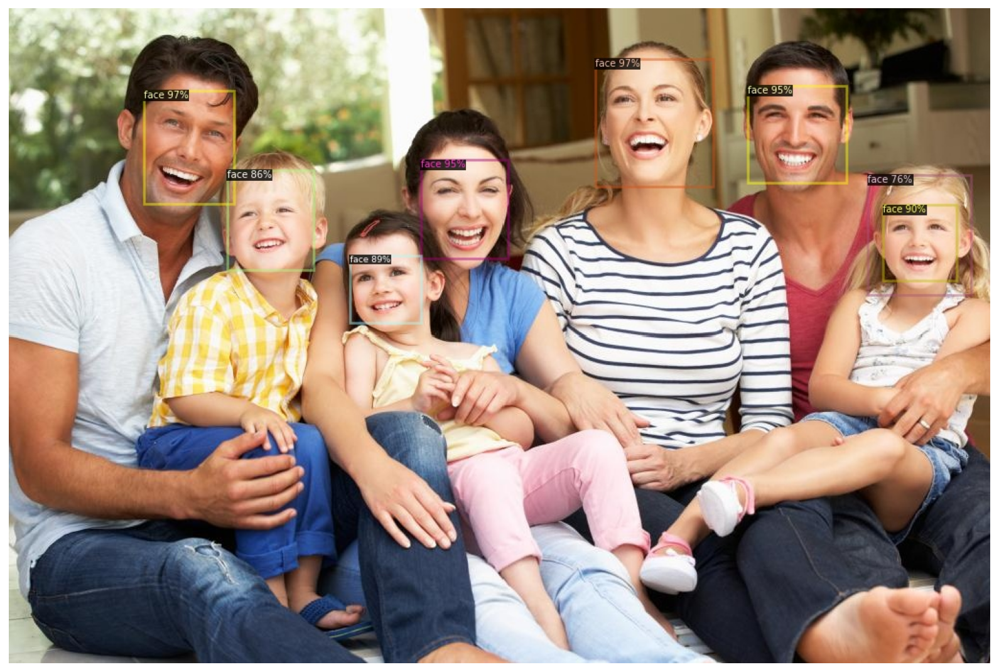

In [ ]:
img = cv2.cvtColor(cv2.imread(annotated_images[18]), cv2.COLOR_BGR2RGB)

plt.imshow(img)
plt.axis('off');

In [ ]:
!rm -rf annotated_results

Let's do some testing with images NOT in our original dataset.

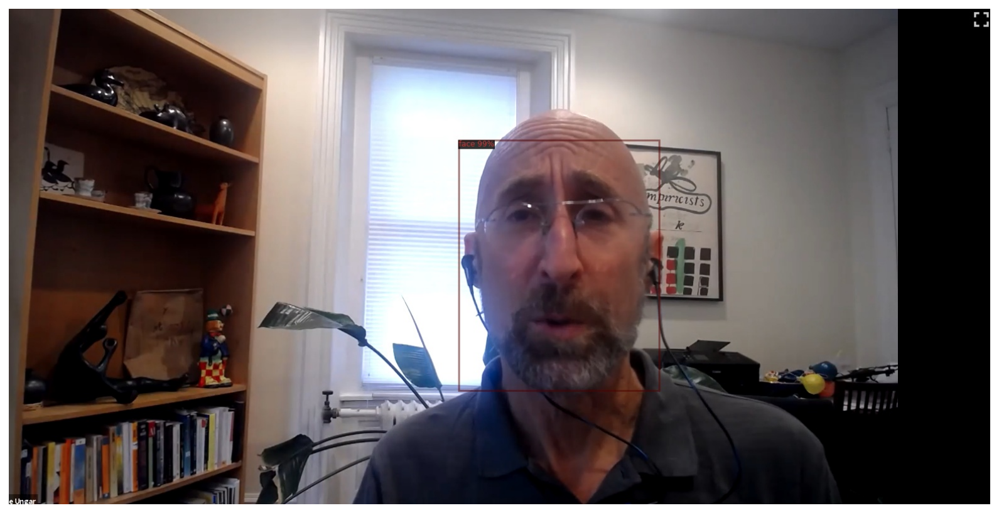

In [ ]:
os.makedirs("annotated_results", exist_ok=True)
# test_image = ['test1.jpg', 'test2.jpg', 'test3.png']

file_path = f'test3.png'
im = cv2.imread(file_path)
outputs = predictor(im)

#visualize the output
visual = Visualizer(im[:, :, ::-1], metadata=statement_metadata, scale=1., instance_mode=ColorMode.IMAGE)
instances = outputs["instances"].to("cpu")
instances.remove('pred_masks')
visual = visual.draw_instance_predictions(instances)
result = visual.get_image()[:, :, ::-1]
file_name = ntpath.basename(clothing_image)
write_res = cv2.imwrite(f'annotated_results/{file_name}', result)

img = cv2.cvtColor(cv2.imread('annotated_results/face_408.jpeg'), cv2.COLOR_BGR2RGB)
plt.imshow(img)
plt.axis('off');

### Part 1.6: Transition to Emotion Recognition

After successfully localizing the faces, we then crop out the faces, reszie and feed them into our second model!

In [ ]:
#### Cropping Detected Faces and Resizing ####

file_name = '/content/test3.png'

bounding_boxes = outputs['instances'].pred_boxes.tensor

image = cv2.imread(file_name,0) # Reading and Converting image to grayscale
image = np.array(image)         # Converting image to np.array


#bl => bottom left
#tr => top right
x_bl = []
y_bl = []

x_tr = []
y_tr = []
for i in range(0,bounding_boxes.shape[0]):
  x_bl.append(int(bounding_boxes[i][0]))
  y_bl.append(int(bounding_boxes[i][1]))

  x_tr.append(int(bounding_boxes[i][2]))
  y_tr.append(int(bounding_boxes[i][3]))

crop_faces = []
for k in range(0,bounding_boxes.shape[0]):
  crop = image[y_bl[k]:y_tr[k],x_bl[k]:x_tr[k]]
  crop = cv2.resize(crop, (48,48))    # Rescale to appropriate size
  crop_faces.append(crop)

crop_faces = np.array(crop_faces)    #crop faces array
print(crop_faces.shape)

(1, 48, 48)


This is a grey-scale, 48x48 image that is cropped out from the first model.

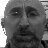

In [ ]:
cv2_imshow(crop_faces[0])

In [ ]:
#double check the type of the image. See Part 3 for the complete process
test_face = crop_faces[0].astype(float)
test_face = (test_face/255 - 0.5)*2
test_face

array([[ 0.99215686,  0.99215686,  0.99215686, ...,  0.52941176,
         0.51372549,  0.48235294],
       [ 0.98431373,  0.98431373,  0.98431373, ..., -0.46666667,
        -0.46666667, -0.52156863],
       [ 0.98431373,  0.97647059,  0.97647059, ...,  0.49019608,
         0.41960784,  0.29411765],
       ...,
       [ 1.        ,  1.        ,  1.        , ..., -0.74117647,
        -0.6627451 , -0.50588235],
       [ 0.94509804,  0.94509804,  0.9372549 , ..., -0.75686275,
        -0.7254902 , -0.63137255],
       [ 0.27843137,  0.2627451 ,  0.25490196, ..., -0.81960784,
        -0.70980392, -0.63137255]])

## Part 2: Facial Expression Recognition

### Part 2.1: KNN

Because of its intuitive approach and simplicity, KNN ischosen to be the  baseline of our emotion classificationproblem. We used the KNeighborsClassifier from scikit-learn to develop and evaluate the baseline model. 

In [ ]:
from sklearn.neighbors import KNeighborsClassifier
import pandas as pd
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow
from matplotlib import pyplot as plt

#### 2.1.1: Downloading & Processing Data

The [FER dataset](https://www.kaggle.com/c/challenges-in-representation-learning-facial-expression-recognition-challenge/data) consists of 48x48 pixel grayscale images of faces. The faces have been automatically registered so that the face is more or less centered and occupies about the same amount of space in each image, and each face is labelled one of the seven emotions (0=Angry, 1=Disgust, 2=Fear, 3=Happy, 4=Sad, 5=Surprise, 6=Neutral)

In [ ]:
!pip install kaggle

In [ ]:
from google.colab import files
files.upload()

In [ ]:
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 /root/.kaggle/kaggle.json

In [ ]:
!kaggle competitions download -c challenges-in-representation-learning-facial-expression-recognition-challenge

In [ ]:
!unzip train.csv.zip
!unzip test.csv.zip

In [ ]:
train_file = pd.read_csv('train.csv')
test_file = pd.read_csv('test.csv')

In [ ]:
pixels_train = train_file['pixels'].tolist()
emotions_train = train_file['emotion'].tolist()
pixels_test = test_file['pixels'].tolist()

In [ ]:
faces_train = []
faces_test = []
for pixel_sequence in pixels_train:
    pic = np.array([np.uint8(pixel) for pixel in pixel_sequence.split(' ')]).reshape((48,48))
    faces_train.append(pic)

for pixel_sequence in pixels_test:
    pic = np.array([np.uint8(pixel) for pixel in pixel_sequence.split(' ')]).reshape((48,48))
    faces_test.append(pic)

In [ ]:
faces_train = np.array(faces_train)              ### Face_train array
faces_test = np.array(faces_test)                ### Face_test array

emotions_train = pd.get_dummies(train_file['emotion'])
emotions_train = np.array(emotions_train)        ### emotion array

print(faces_train.shape)
print(emotions_train.shape)
print(faces_test.shape)

#### 2.1.2: Image Representation

The classifier’s  performance heavily depends not only on the  selected features of the input image, but also on the hyperparameters of the model. We tried two methods of extracting features of an input image: The first method is to represent the image using its flatten raw pixel array, and the second  method is to convert the image into its colorhistogram. For each method, different settings of hyperparameters are considered to evaluate the model accuracy

##### Raw Pixel Representation

In [ ]:
### Splitting Date for Training and Validation
X_train_raw = faces_train[0:28600]
X_train_raw = np.reshape(X_train_raw,(28600, 48*48))  ## Flattening the training images
y_train_raw = emotions_train[0:28600]
X_val = faces_train[28601 : 28709]
X_val = np.reshape(X_val,(108,48*48))         ## Flattening the validation images
y_val = emotions_train[28601 : 28709]

print(X_train_raw.shape)
print(y_train_raw.shape)
print(X_val.shape)
print(y_val.shape)

In [ ]:
### Normalizing Training and Validation Data ###
X_train = ((X_train/255) - 0.5)*2  ## Normalize from 0->255 to -1->1
X_val = ((X_val/255) - 0.5)*2      ## Normalize from 0->255 to -1->1

##### Color-Histogram Representation

In [ ]:
### Convert Images to ColorHistogram ###
train_list = []
for i in range(0,faces_train.shape[0]):
  hist,bin = np.histogram(faces_train[i],256,[0,256])
  train_list.append(hist)

test_list = []
for i in range(0,faces_test.shape[0]):
  hist,bin = np.histogram(faces_test[i],256,[0,256])
  test_list.append(hist)

In [ ]:
train_array = np.array(train_list)    # Color historgram of trainset
test_array = np.array(test_list)      # Color historgram of testset
print(train_array.shape)
print(test_array.shape)

In [ ]:
### Splitting Date for Training and Validation ###
X_train_color = train_array[:27709]
y_train_color = emotions_train[:27709]

X_val = train_array[27709:]
y_val = emotions_train[27709:]

print(X_train_color.shape)
print(y_train_color.shape)
print(X_val.shape)
print(y_val.shape)

#### 2.1.3: Training

In [ ]:
### Training KNN Model - Raw Pixel ###
KNN = KNeighborsClassifier(n_neighbors=3,weights='distance',p=1)
KNN.fit(X_train_raw,y_train_raw)

### Training KNN Model - Color Histogram ###
KNN = KNeighborsClassifier(n_neighbors=3,weights='distance',p=1)
KNN.fit(X_train_color,y_train_color)

#### 2.1.4: Evaluation

The hyperparameters of our KNN classifier are tuned by considering different configurations of:
- Weightings
- Norm types
- Number of neighbors.

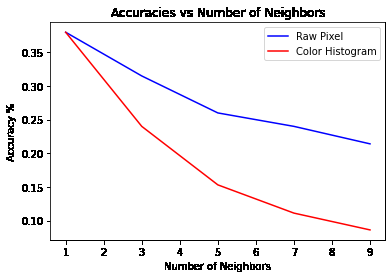

In [ ]:
accuracies_raw = []
accuracies_color = []
Ks = [1,3,5,7,9]

### Raw Pixel ###
for K in Ks:
  KNN = KNeighborsClassifier(n_neighbors=K,weights='distance',p=1)
  KNN.fit(X_train_raw,y_train_raw)
  accuracies_raw.append(KNN.score(X_val,y_val))

### Color Histogram ###
for K in Ks:
  KNN = KNeighborsClassifier(n_neighbors=K,weights='distance',p=1)
  KNN.fit(X_train_color,y_train_color)
  accuracies_color.append(KNN.score(X_val,y_val))

### Accuracies vs Number of Neighbors ###
plt.plot(Ks,accuracies_raw,'b',label = 'Raw Pixel')
plt.plot(Ks,accuracies_color,'r',label = 'Color Histogram')
plt.legend(loc="upper right")
plt.title("Accuracies vs Number of Neighbors")
plt.ylabel("Accuracy %")
plt.xlabel("Number of Neighbors")
plt.show()

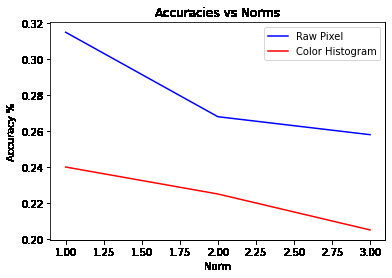

In [ ]:
accuracies_raw = []
accuracies_color = []
Ps = [1,2,3]

### Raw Pixel ###
for P in Ps:
  KNN = KNeighborsClassifier(n_neighbors=3,weights='distance',p=P)
  KNN.fit(X_train_raw,y_train_raw)
  accuracies_raw.append(KNN.score(X_val,y_val))

### Color Histogram ###
for P in Ps:
  KNN = KNeighborsClassifier(n_neighbors=3,weights='distance',p=P)
  KNN.fit(X_train_color,y_train_color)
  accuracies_color.append(KNN.score(X_val,y_val))

### Accuracies vs Norms ###
plt.plot(Ps,accuracies_raw,'b',label = 'Raw Pixel')
plt.plot(Ps,accuracies_color,'r',label = 'Color Histogram')
plt.legend(loc="upper right")
plt.title("Accuracies vs Norms")
plt.ylabel("Accuracy %")
plt.xlabel("Norm")
plt.show()

#### 2.1.5: Findings and Conclusion

We learn that to "decode" the emotion of a face image, it is more effective to consider the contours (raw pixel array) of the image rather then the colors ( color histogram) presented in the image. This result gives us more confidence in our choice of using Neural Network models as the alternatives which have been proven to be very effective in analysing images in their raw pixel forms

### Part 2.2: Multilayer Perceptron

Multilayer Perceptron (MLP) is chosen as our first approach of using neural networks to process raw pixels representation of images.

In [ ]:
import pandas as pd
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow
from matplotlib import pyplot as plt

import torch
import torch.nn as nn 
import torch.nn.functional as F

#### 2.2.1: Downloading & Processing Data

The [FER dataset](https://www.kaggle.com/c/challenges-in-representation-learning-facial-expression-recognition-challenge/data) consists of 48x48 pixel grayscale images of faces. The faces have been automatically registered so that the face is more or less centered and occupies about the same amount of space in each image, and each face is labelled one of the seven emotions (0=Angry, 1=Disgust, 2=Fear, 3=Happy, 4=Sad, 5=Surprise, 6=Neutral)

In [ ]:
!pip install kaggle

In [ ]:
from google.colab import files
files.upload()

In [ ]:
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 /root/.kaggle/kaggle.json  

In [ ]:
!kaggle competitions download -c challenges-in-representation-learning-facial-expression-recognition-challenge

In [ ]:
!unzip train.csv.zip
!unzip test.csv.zip

In [ ]:
train_file = pd.read_csv('train.csv')
test_file = pd.read_csv('test.csv')

In [ ]:
pixels_train = train_file['pixels'].tolist()
emotions_train = train_file['emotion'].tolist()
pixels_test = test_file['pixels'].tolist()

In [ ]:
faces_train = []
faces_test = []
for pixel_sequence in pixels_train:
    pic = np.array([np.uint8(pixel) for pixel in pixel_sequence.split(' ')]).reshape((48,48))
    faces_train.append(pic)

for pixel_sequence in pixels_test:
    pic = np.array([np.uint8(pixel) for pixel in pixel_sequence.split(' ')]).reshape((48,48))
    faces_test.append(pic)

In [ ]:
faces_train = np.array(faces_train)              ### Face_train array
faces_test = np.array(faces_test)                ### Face_test array

emotions_train = pd.get_dummies(train_file['emotion'])
emotions_train = np.array(emotions_train)        ### emotion array

print(faces_train.shape)
print(emotions_train.shape)
print(faces_test.shape)

In [ ]:
### Index Encoding ###
emotion_index_list = []
for i in range(0,emotions_train.shape[0]):
  emotion_index = np.argmax(emotions_train[i])
  emotion_index_list.append(emotion_index)

emotions_train = np.array(emotion_index_list)
print(emotions_train.shape)

In [ ]:
### Splitting Date for Training and Validation ###
X_train = faces_train[:27600]
y_train = emotions_train[:27600]
X_val = faces_train[27600 : ]
y_val = emotions_train[27600 :]

print(X_train.shape)
print(y_train.shape)
print(X_val.shape)
print(y_val.shape)

In [ ]:
### Converting numpy array to tensor and Changing datatype ###
X_train = torch.tensor([i for i in X_train])
X_train = X_train.type(torch.LongTensor)
X_train = (X_train /255 - 0.5)*2

y_train = torch.tensor([i for i in y_train])
y_train = y_train.type(torch.LongTensor)

X_val = torch.tensor([i for i in X_val])
X_val = X_val.type(torch.LongTensor)
X_val = (X_val /255 - 0.5)*2

y_val = torch.tensor([i for i in y_val])
y_val = y_val.type(torch.LongTensor)

#### 2.2.2: MLP Model

The MLP model is implemented using Pytorch and its architecture is as follows:

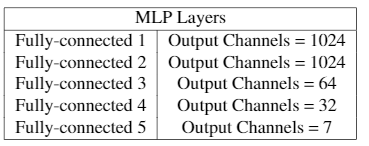

Different activation functions (Sigmoid, Relu and Tanh) will be evaluated to determine which function would help to extract the most emotion-related features from input images.


##### Sigmoid Activation Function

In [ ]:
class Net_sigmoid(nn.Module):
  def __init__(self):   
    super().__init__()
    self.fc1 = nn.Linear(48*48,1024) 
    self.fc2 = nn.Linear(1024,1024)    
    self.fc3 = nn.Linear(1024,64)  
    self.fc4 = nn.Linear(64,32)  
    self.fc5 = nn.Linear(32,7)   
    

  def forward(self,x): 
    x = torch.sigmoid(self.fc1(x))    
    x = torch.sigmoid(self.fc2(x)) 
    x = torch.sigmoid(self.fc3(x))   
    x = torch.sigmoid(self.fc4(x))  
    x = self.fc5(x)    
                              
    return x

net_sigmoid = Net_sigmoid()
print(net_sigmoid)

##### Relu Activation Function

In [ ]:
class Net_relu(nn.Module):
  def __init__(self):   
    super().__init__()
    self.fc1 = nn.Linear(48*48,1024) 
    self.fc2 = nn.Linear(1024,1024)    
    self.fc3 = nn.Linear(1024,64)  
    self.fc4 = nn.Linear(64,32)  
    self.fc5 = nn.Linear(32,7)   
    

  def forward(self,x): 
    x = torch.relu(self.fc1(x))    
    x = torch.relu(self.fc2(x)) 
    x = torch.relu(self.fc3(x))   
    x = torch.relu(self.fc4(x))  
    x = self.fc5(x)    
                              
    return x

net_relu = Net_relu()
print(net_relu)

##### Tanh Activation Function

In [ ]:
class Net_tanh(nn.Module):
  def __init__(self):   
    super().__init__()
    self.fc1 = nn.Linear(48*48,1024) 
    self.fc2 = nn.Linear(1024,1024)    
    self.fc3 = nn.Linear(1024,64)  
    self.fc4 = nn.Linear(64,32)  
    self.fc5 = nn.Linear(32,7)   
    

  def forward(self,x): 
    x = torch.tanh(self.fc1(x))    
    x = torch.tanh(self.fc2(x)) 
    x = torch.tanh(self.fc3(x))   
    x = torch.tanh(self.fc4(x))  
    x = self.fc5(x)    
                              
    return x

net_tanh = Net_tanh()
print(net_tanh)

#### 2.2.3: Training

To select the best activation function for our problem, we will train the model using either Sigmoid, Relu or Tanh function and run the model through 50 epochs. The activation function, which not only results in the highest testing accuracy but also has the best loss convergence, will be selected.

##### Sigmoid Model

In [ ]:
import torch.optim as optim
from tqdm import tqdm

optimizer = optim.Adam(net_sigmoid.parameters(), lr=0.001)
loss_function = nn.CrossEntropyLoss()

batch_size = 160

EPOCHS = 50
error_list_sigmoid = []

for epoch in range(EPOCHS):
  for i in tqdm(range(0,len(X_train),batch_size)):
    X_batch = X_train[i:i+batch_size]
    y_batch = y_train[i:i+batch_size]
    net_sigmoid.zero_grad
    outputs = net_sigmoid(X_batch.view(-1,48*48))
    loss = loss_function(outputs,y_batch)
    loss.backward()
    optimizer.step()
  error_list_sigmoid.append(loss)

##### Relu Model

In [ ]:
import torch.optim as optim
from tqdm import tqdm

optimizer = optim.Adam(net_relu.parameters(), lr=0.001)
loss_function = nn.CrossEntropyLoss()

batch_size = 160

EPOCHS = 50
error_list_relu = []

for epoch in range(EPOCHS):
  for i in tqdm(range(0,len(X_train),batch_size)):
    X_batch = X_train[i:i+batch_size]
    y_batch = y_train[i:i+batch_size]
    net_relu.zero_grad
    outputs = net_relu(X_batch.view(-1,48*48))
    loss = loss_function(outputs,y_batch)
    loss.backward()
    optimizer.step()
  error_list_relu.append(loss)

##### Tanh Model

In [ ]:
import torch.optim as optim
from tqdm import tqdm

optimizer = optim.Adam(net_tanh.parameters(), lr=0.001)
loss_function = nn.CrossEntropyLoss()

batch_size = 160

EPOCHS = 50
error_list_tanh = []

for epoch in range(EPOCHS):
  for i in tqdm(range(0,len(X_train),batch_size)):
    X_batch = X_train[i:i+batch_size]
    y_batch = y_train[i:i+batch_size]
    net_tanh.zero_grad
    outputs = net_tanh(X_batch.view(-1,48*48))
    loss = loss_function(outputs,y_batch)
    loss.backward()
    optimizer.step()
  error_list_tanh.append(loss)

#### 2.2.4: Evaluation

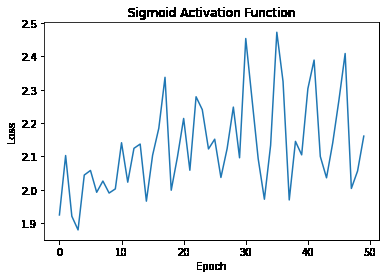

In [ ]:
plt.plot(error_list_sigmoid)
plt.title("Sigmoid Activation Function")
plt.ylabel("Loss")
plt.xlabel("Epoch")
plt.show()

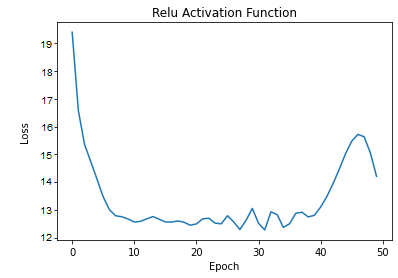

In [ ]:
plt.plot(error_list_relu)
plt.title("Relu Activation Function")
plt.ylabel("Loss")
plt.xlabel("Epoch")
plt.show()

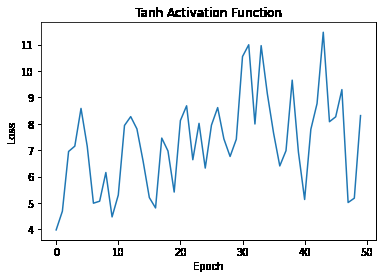

In [ ]:
plt.plot(error_list_tanh)
plt.title("Tanh Activation Function")
plt.ylabel("Loss")
plt.xlabel("Epoch")
plt.show()

#### 2.2.5: Findings and Conclusion

We learn that it is not effective to use only fully-connected layers to decode emotions from raw pixels. Because there are alot of irrelevant features such  as background colors and skin colors, weighting all pixels would only cause the model to stuck at some local minimums or even unable toconverge at all. As a result, using convolutional neural network (CNN) would be our next best approach, since CNN can detect more relevant features such as eyes and mouths by considering local receptive fields instead of the entire raw pixel array.

### Part 2.3: Convolutional Neural Network
In this section, will implemented two CNN models to perform emotion recognition on the FER dataset. 
- For the first model, we created our own CNN architecutre. The model is simple and the final accuracy is about 55%.
- For the second model, we used the ResNet architecture and loaded pre-trained weights as the starting point. This model outperfoms our CNN model at the first epoch and ends up with a accuracy about 62%.

In [ ]:
import os
import pandas as pd
import cv2
import numpy as np
import torch
from torch.utils.data import DataLoader

PROJECT_FOLDER = "/content/drive/MyDrive/CIS520/Final_Project"
DATA_PATH = "/content/drive/MyDrive/CIS520/Final_Project/data/emotion"

#### 2.3.1 Data Processing for CNN

The [FER dataset](https://www.kaggle.com/c/challenges-in-representation-learning-facial-expression-recognition-challenge/data) consists of 48x48 pixel grayscale images of faces. The faces have been automatically registered so that the face is more or less centered and occupies about the same amount of space in each image. The task is to categorize each face based on the emotion shown in the facial expression in to one of seven categories (0=Angry, 1=Disgust, 2=Fear, 3=Happy, 4=Sad, 5=Surprise, 6=Neutral).

The images are provided as .csv files, so in the preprocessing phase, we load the images from .csv file and normalize the images to (-1, 1) range. The data is loaded into a pytorch Dataset and loaded using pytorch DataLoader.

In [ ]:
class BuildDataset(torch.utils.data.Dataset):
    def __init__(self, dataset_path, image_size):
        self.image_size = image_size
        self.faces, self.emotions = self.load_face_expression_dataset(dataset_path)
        self.faces = self.preprocess_input(self.faces)
        

    def __getitem__(self, index):
        return self.faces[index].transpose(2, 0, 1), self.emotions[index]

    def __len__(self):
        return self.faces.shape[0]

    def load_face_expression_dataset(self, dataset_path):
        '''
        1. Read in the data from dataset_path into a pandas dataframe
        2. convert the 'pixels' column to a list and convert pixel sequence of each row in image of dimension 48*48

        Args:
            dataset_path: string, path to the face expression data set
        Returns:
            faces: array, (n, width, height, channel), face images
            emotions: array, (n, n_class), one-hot encoded labels
        '''
        data = pd.read_csv(dataset_path)
        pixels = data['pixels'].tolist()
        width, height = self.image_size
        faces = []
        for pixel_sequence in pixels:
            pic = np.array([np.uint8(pixel) for pixel in pixel_sequence.split(' ')]).reshape(image_size)
            faces.append(pic)

        faces = np.asarray(faces)
        faces = np.expand_dims(faces, -1)
        emotions = data['emotion']
        return faces, emotions
    
    def preprocess_input(self, face_image):
        ''' 
        It is a standard way to pre-process images by scaling them between -1 to 1. 
        Face images are scaled to [0,1] by dividing it by 255 (Make sure to convert integer images to floats before)
        Further, subtraction by 0.5 and multiplication by 2 changes the range to [-1,1]

            Args: 
                face_image: array, original face images

            Returns:
                ret: normalized face images
        '''
        ret = []
        for k in range(0, len(face_image)):
            face = face_image[k]
            curr_img = np.ndarray(shape=[48,48,1], dtype=float)
            for i in range(0, 48):
                for j in range(0, 48):
                    curr_img[i,j,0] = (float(face[i,j,0])/255 - 0.5)*2
            
            ret.append(curr_img)
        ret = np.asarray(ret)
        return ret

#### 2.3.2 Simple CNN Model

##### 2.3.2.1 CNN Model

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torchvision.utils import save_image
import matplotlib.pyplot as plt
import numpy as np

class emotionCNN(nn.Module):
    def __init__(self):
        super(emotionCNN, self).__init__()
        # Convolutional layers
        self.conv = nn.Sequential(
            nn.Conv2d(in_channels=1, out_channels=64, kernel_size=5, stride=1, padding=0),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=5, stride=2),
            nn.Conv2d(in_channels=64, out_channels=64, kernel_size=3, stride=1, padding=0),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=3, stride=2),
            nn.Conv2d(in_channels=64, out_channels=128, kernel_size=3, stride=1, padding=0),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=3, stride=2),
        )
        # Fully-connected layers
        self.fc = nn.Sequential(
            nn.Linear(512, 1024),
            nn.ReLU(),
            nn.Linear(1024, 1024),
            nn.ReLU(),
            nn.Linear(1024, 7),
        )
    
    def _init_weight(self):
        pass
    
    def forward(self, X):
        X = self.conv(X)
        X = X.flatten(start_dim=1)
        X = self.fc(X)

        return X
    

In [ ]:
def validation_step(model):
    model.eval()
    val_loss = 0
    val_acc = 0
    correct = 0
    count = 0
    with torch.no_grad():
        for iter, batch in enumerate(tqdm(test_loader), 0):
            images = batch[0].to(device)
            labels = batch[1].to(device)

            # calculate loss
            class_logits= model.forward(images.float())
            loss = criterion(class_logits, labels)
            val_loss += loss.item()

            # calculate accuracy
            pred_cls = torch.argmax(softmax(class_logits), dim=1)
            correct += (labels.eq(pred_cls)).sum()
            count += labels.shape[0]
        
        val_acc = correct/count
        val_loss = val_loss/iter

    return val_loss, val_acc

##### 2.3.2.2 Training

In [ ]:
from tqdm.notebook import tqdm
import time
# Load data
batch_size = 128
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=4)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, num_workers=4)

# Create model
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = emotionCNN().to(device)

# Train the network
start_epoch = 0
num_epochs = 10
optimizer = optim.Adam(model.parameters(), lr=0.001)
criterion = nn.CrossEntropyLoss()

train_loss_list = []
val_loss_list = []
train_acc_list = []
val_acc_list = []
num_batches = 0
print("Training Start......")
for epoch in range(start_epoch, num_epochs):
    print("Epoch {} Starting......".format(epoch+1))

    model.train()
    start_time = time.time()
    running_train_loss = []
    running_corrects = 0
    for iter, batch in enumerate(tqdm(train_loader), 0):
        images = batch[0].to(device)
        labels = batch[1].to(device)

        # training step
        optimizer.zero_grad()
        class_logits= model.forward(images.float())
        loss = criterion(class_logits, labels)
        loss.backward()
        optimizer.step()
       
        # record loss for current batch
        running_train_loss.append(loss.item())
        _, preds = torch.max(class_logits, 1)
        running_corrects += torch.sum(preds == labels.data)
        # log the progress for each 25 batches
        # if iter % 25 == 0 and iter != 0:
        #     print("finished {} batch, train_loss: {}".format(iter, np.mean(running_train_loss)))
        #     print("--- %s seconds ---" % (time.time() - start_time))
        #     start_time = time.time()

        num_batches += 1
    train_acc = running_corrects/len(train_dataset)
    # validation
    print("Validation Starting......")
    val_loss, val_acc = validation_step(model)

    # record loss for current epoch
    train_loss_list.append(np.mean(running_train_loss))
    val_loss_list.append(val_loss)
    train_acc_list.append(train_acc)
    val_acc_list.append(val_acc)
    print("Epoch {} train_loss:{}, train_acc:{}, val_loss:{}, val_acc:{}".format(epoch+1,np.mean(running_train_loss), train_acc, val_loss, val_acc))


Training Start......
Epoch 1 Starting......



Validation Starting......



Epoch 1 train_loss:1.7253173430760702, train_acc:0.28896862268447876, val_loss:1.597903664622988, val_acc:0.38464754819869995
Epoch 2 Starting......



Validation Starting......



Epoch 2 train_loss:1.485117760234409, train_acc:0.4186840355396271, val_loss:1.4308564003024782, val_acc:0.45862358808517456
Epoch 3 Starting......



Validation Starting......



Epoch 3 train_loss:1.3684094640943738, train_acc:0.468424528837204, val_loss:1.3703960818903786, val_acc:0.47561997175216675
Epoch 4 Starting......



Validation Starting......



Epoch 4 train_loss:1.2802020128568012, train_acc:0.5104671120643616, val_loss:1.3138535278184074, val_acc:0.5108665823936462
Epoch 5 Starting......



Validation Starting......



Epoch 5 train_loss:1.2285292800267538, train_acc:0.5346407294273376, val_loss:1.2930319117648261, val_acc:0.5217331051826477
Epoch 6 Starting......



Validation Starting......



Epoch 6 train_loss:1.1824249815940857, train_acc:0.5503848791122437, val_loss:1.2588492802211217, val_acc:0.5321816802024841
Epoch 7 Starting......



Validation Starting......



Epoch 7 train_loss:1.1375358441140917, train_acc:0.5656065940856934, val_loss:1.25257722394807, val_acc:0.5270270705223083
Epoch 8 Starting......



Validation Starting......



Epoch 8 train_loss:1.0863460604349773, train_acc:0.5881431102752686, val_loss:1.2723006797688348, val_acc:0.5369184017181396
Epoch 9 Starting......



Validation Starting......



Epoch 9 train_loss:1.0557391089863248, train_acc:0.6018670201301575, val_loss:1.2458447813987732, val_acc:0.5456951856613159
Epoch 10 Starting......



Validation Starting......



Epoch 10 train_loss:1.0005018671353658, train_acc:0.6201887726783752, val_loss:1.2335708396775382, val_acc:0.5479242205619812


##### 2.3.2.3 Evaluation

Using this simple CNN model, we get a prediction accuracy about 55% on the test dataset after training for 10 epochs.

Text(0.5, 1.0, 'Accuracy vs. Epcoh')

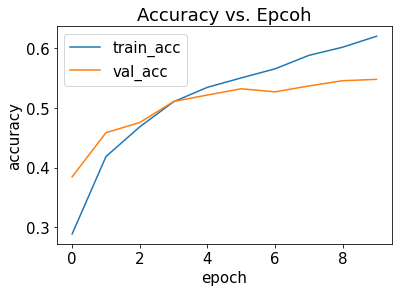

In [ ]:
plt.plot(train_acc_list, label='train_acc')
plt.plot(val_acc_list, label='val_acc')
plt.legend()
plt.xlabel('epoch')
plt.ylabel('accuracy')
plt.title("Accuracy vs. Epcoh")

#### 2.3.3 ResNet

ResNet-18 is a convolutional neural network that is 18 layers deep. For this model we load a pretrained version of the network trained on more than a million images from the ImageNet database. The pretrained network can classify images into 1000 object categories, such as keyboard, mouse, pencil, and many animals. As a result, the network has learned rich feature representations for a wide range of images. We replace the last few layers with our fully-connected layers and trained the network for few epochs on the FER dataset. The accuracy outperforms the simple CNN model in the first epoch of training and the final accuracy is about 63%.

##### 2.3.3.1 Load Data

In [ ]:
# Read the data to create Dataset
dataset_path = os.path.join(DATA_PATH, 'fer2013.csv')
image_size=(48,48)
dataset = BuildDataset(dataset_path, image_size)

In [ ]:
# Build the dataloader

# set 20% of the dataset as the training data
full_size = len(dataset)
train_size = int(full_size * 0.8)
test_size = full_size - train_size
# random split the dataset into training and testset
torch.random.manual_seed(1)
train_dataset, test_dataset = torch.utils.data.random_split(dataset, [train_size, test_size])

# Create dataloader
dataloaders = {}
dataset_sizes = {}
batch_size = 16
dataset_sizes['train'] = len(train_dataset)
dataset_sizes['val'] = len(test_dataset)
dataloaders['train'] = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=4)
dataloaders['val'] = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, num_workers=4)

##### 2.3.3.2 CNN Model

In [ ]:
import time
import copy
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.optim import lr_scheduler
from torchvision import datasets, models, transforms
from torchvision.utils import save_image
from tqdm.notebook import tqdm
import matplotlib.pyplot as plt
import numpy as np

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Load the ResNet18 Model
model_conv = models.resnet18(pretrained=True)

# Replace the fully-connected layers
num_ftrs = model_conv.fc.in_features
model_conv.fc = nn.Sequential(
            nn.Linear(512, 1024),
            nn.ReLU(),
            nn.Linear(1024, 1024),
            nn.ReLU(),
            nn.Linear(1024, 7),
        )

model_conv = model_conv.to(device)
criterion = nn.CrossEntropyLoss()
# Using the SGD optimizer with learning rate 0.001 and momentum of 0.9
optimizer_conv = optim.SGD(model_conv.parameters(), lr=0.001, momentum=0.9)
# Decay LR by a factor of 0.1 every 7 epochs
exp_lr_scheduler = lr_scheduler.StepLR(optimizer_conv, step_size=7, gamma=0.1)

##### 2.3.3.3 Training

In [ ]:
def train_model(model, criterion, optimizer, scheduler, num_epochs=10):
    since = time.time()
    Loss = {'train':[], 'val':[]}
    Acc = {'train':[], 'val':[]}

    best_model_wts = copy.deepcopy(model.state_dict())
    best_acc = 0.0

    for epoch in range(num_epochs):
        print('Epoch {}/{}'.format(epoch, num_epochs - 1))
        print('-' * 10)

        # Each epoch has a training and validation phase
        for phase in ['train', 'val']:
            if phase == 'train':
                model.train()  # Set model to training mode
            else:
                model.eval()   # Set model to evaluate mode

            running_loss = 0.0
            running_corrects = 0

            # Iterate over data.
            for inputs, labels in tqdm(dataloaders[phase]):
                rgb_inputs = torch.cat((inputs, inputs, inputs), dim=1)
                inputs = rgb_inputs.float().to(device)
                labels = labels.to(device)

                # zero the parameter gradients
                optimizer.zero_grad()

                # forward
                # track history if only in train
                with torch.set_grad_enabled(phase == 'train'):
                    outputs = model(inputs)
                    _, preds = torch.max(outputs, 1)
                    loss = criterion(outputs, labels)

                    # backward + optimize only if in training phase
                    if phase == 'train':
                        loss.backward()
                        optimizer.step()

                # statistics
                running_loss += loss.item() * inputs.size(0)
                running_corrects += torch.sum(preds == labels.data)
            if phase == 'train':
                scheduler.step()
                pass
                

            epoch_loss = running_loss / dataset_sizes[phase]
            epoch_acc = running_corrects.double() / dataset_sizes[phase]

            print('{} Loss: {:.4f} Acc: {:.4f}'.format(
                phase, epoch_loss, epoch_acc))

            Loss[phase].append(epoch_loss)
            Acc[phase].append(epoch_acc)
            # deep copy the model
            if phase == 'val' and epoch_acc > best_acc:
                best_acc = epoch_acc
                best_model_wts = copy.deepcopy(model.state_dict())

        print()

    time_elapsed = time.time() - since
    print('Training complete in {:.0f}m {:.0f}s'.format(
        time_elapsed // 60, time_elapsed % 60))
    print('Best val Acc: {:4f}'.format(best_acc))

    # load best model weights
    model.load_state_dict(best_model_wts)
    return model, Loss, Acc

In [ ]:
TRAIN = False
path = os.path.join(PROJECT_FOLDER, 'ResNetCNN_checkpoint')
if (TRAIN):
    best_model, loss, accuracy = train_model(model_conv, criterion, optimizer_conv, exp_lr_scheduler)
    # save the trained model
    torch.save({
            'model_state_dict': best_model.state_dict(),
            'optimizer_state_dict': optimizer.state_dict()
            }, path)
else:
    # load the model
    pass

###### Accuracy Curve

Text(0.5, 1.0, 'Accuracy vs. Epcoh')

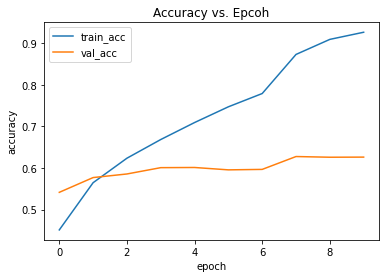

In [ ]:
plt.plot(accuracy['train'], label='train_acc')
plt.plot(accuracy['val'], label='val_acc')
plt.legend()
plt.xlabel('epoch')
plt.ylabel('accuracy')
plt.title("Accuracy vs. Epcoh")

##### 2.3.3.4 Evaluation

###### Confusion Matrix and per class accuracy

In [ ]:
# Save the predictions on the test set for evaluation
test_loader = DataLoader(test_dataset, batch_size=1, shuffle=False, num_workers=4)
emotion_names = ['Angry', 'Disgust', 'Fear', 'Happy', 'Sad', 'Surprise','Neutral']
softmax = nn.Softmax(dim=1)
best_model.eval()
correct_count = 0
y_pred = []
y_true = []
with torch.no_grad():
    for i, data in enumerate(tqdm(test_loader)):
        inputs = data[0].to(device)
        labels = data[1].to(device)
        rgb_inputs = torch.cat((inputs, inputs, inputs), dim=1)
        inputs = rgb_inputs.float().to(device)
        class_logits= best_model(inputs.float())
        pred_clas = torch.argmax(softmax(class_logits), dim=1)
        y_pred.append(pred_clas.item())
        y_true.append(labels.item())

In [ ]:
# Confusion Matrix
def create_confusion_matrix(y_pred, y_true):
    # Return a numpy array of shape NxN as described above
    n_class = len(np.unique(y_pred))
    c_matrix = np.zeros((n_class, n_class), dtype=int)
    y_real = y_true
    for j, i in zip(y_pred, y_real):
        c_matrix[i,j] += 1;

    return c_matrix

confusion_matrix = create_confusion_matrix(y_pred, y_true)
confusion_df = pd.DataFrame(confusion_matrix, columns=emotion_names, index=emotion_names)
confusion_df

,Angry,Disgust,Fear,Happy,Sad,Surprise,Neutral
Angry,479,15,144,51,127,29,130
Disgust,26,64,9,2,8,1,4
Fear,103,3,502,38,159,91,114
Happy,51,0,52,1442,83,50,123
Sad,123,5,158,55,664,15,238
Surprise,22,1,97,28,18,615,33
Neutral,65,0,105,104,166,26,740


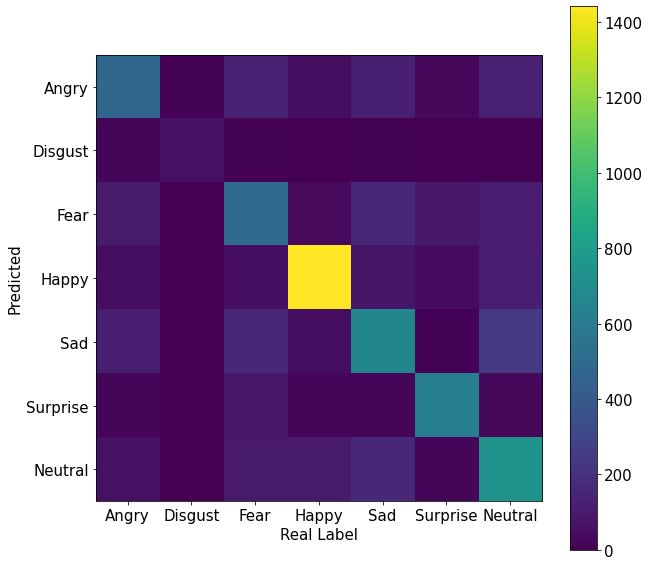

In [ ]:
# Visualized Confusion Matrix
plt.rcParams.update({'font.size': 15})
plt.figure(figsize=(10, 10))
plt.imshow(confusion_matrix)
plt.colorbar()
plt.xticks(np.arange(7), emotion_names)
plt.yticks(np.arange(7), emotion_names)
plt.xlabel('Real Label')
plt.ylabel('Predicted')
plt.show()

In [ ]:
# Per class accuracy
per_class_acc = []
for clas in range(7):
    clas_acc = confusion_matrix[clas, clas] / sum(confusion_matrix[:, clas])
    per_class_acc.append(clas_acc)
    print("{}: {:.4}".format(emotion_names[clas], clas_acc))

Angry: 0.5512
Disgust: 0.7273
Fear: 0.4705
Happy: 0.8384
Sad: 0.542
Surprise: 0.7437
Neutral: 0.5355


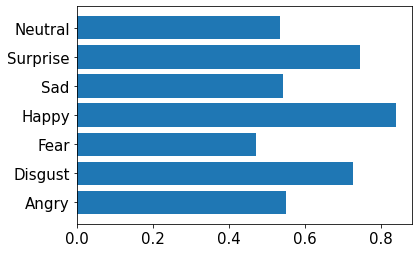

In [ ]:
plt.barh(np.arange(7), per_class_acc)
plt.yticks(np.arange(7), emotion_names)
plt.show()

###### Visualization

predciton: Sad
actual: Sad


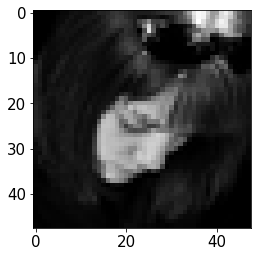

predciton: Neutral
actual: Fear


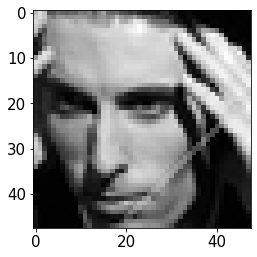

predciton: Neutral
actual: Neutral


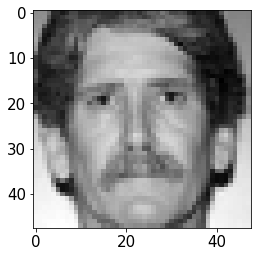

predciton: Sad
actual: Fear


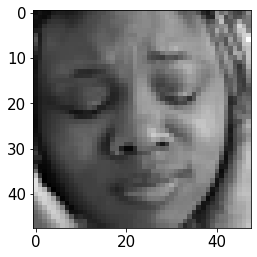

predciton: Surprise
actual: Surprise


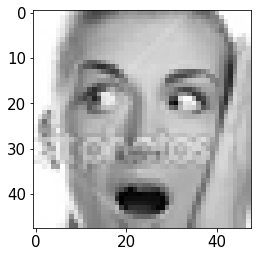

predciton: Happy
actual: Happy


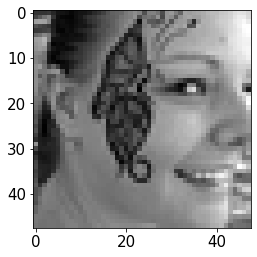

predciton: Angry
actual: Angry


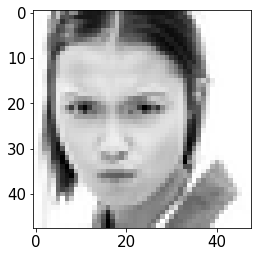

predciton: Sad
actual: Happy


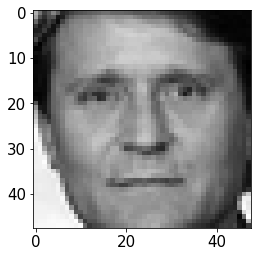

predciton: Sad
actual: Sad


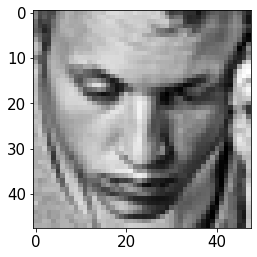

predciton: Happy
actual: Neutral


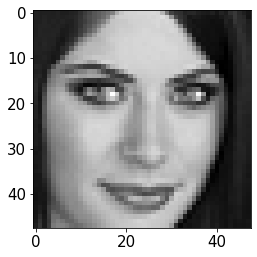

predciton: Angry
actual: Fear


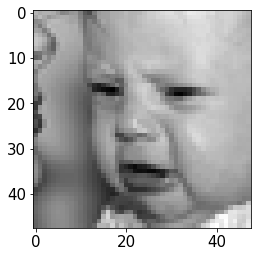

predciton: Happy
actual: Happy


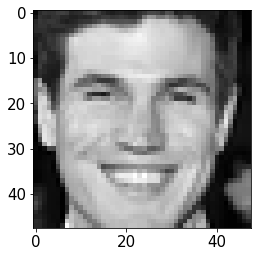

predciton: Neutral
actual: Neutral


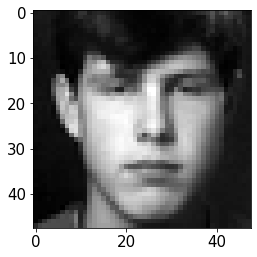

predciton: Fear
actual: Fear


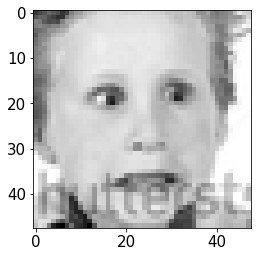

predciton: Happy
actual: Happy


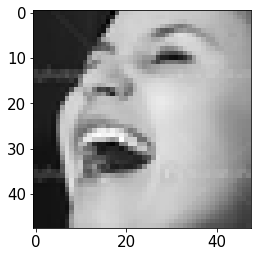

predciton: Happy
actual: Happy


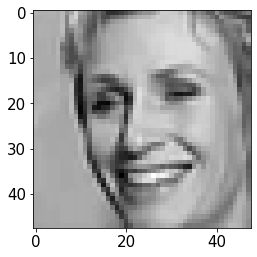

predciton: Happy
actual: Happy


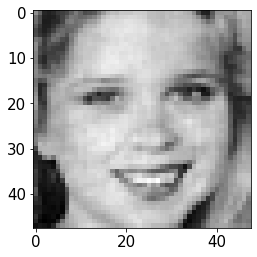

predciton: Happy
actual: Happy


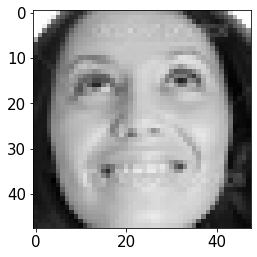

predciton: Neutral
actual: Neutral


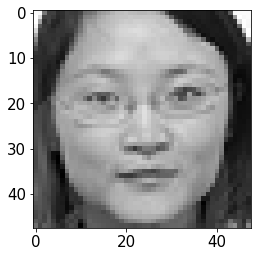

predciton: Neutral
actual: Fear


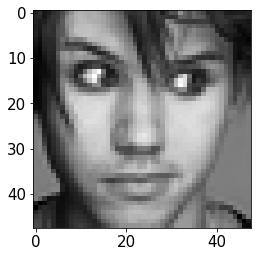

predciton: Neutral
actual: Fear


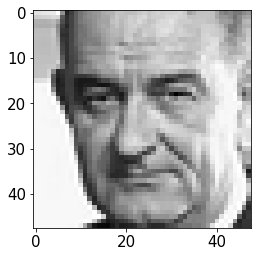

predciton: Surprise
actual: Neutral


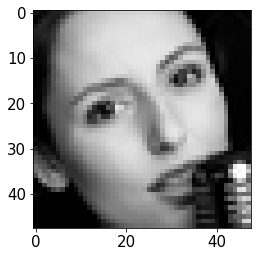

predciton: Happy
actual: Happy


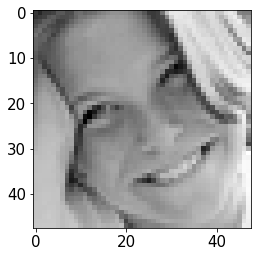

predciton: Sad
actual: Neutral


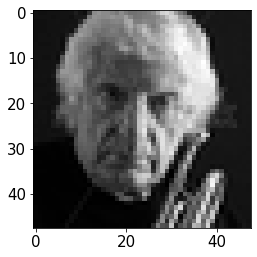

predciton: Angry
actual: Fear


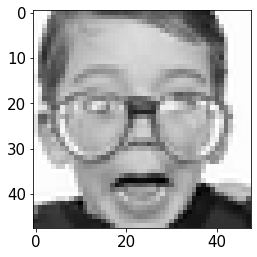

predciton: Fear
actual: Neutral


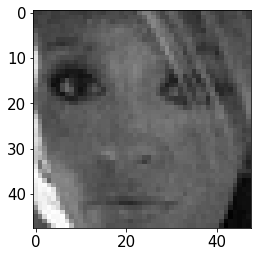

predciton: Fear
actual: Fear


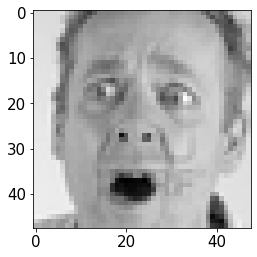

predciton: Disgust
actual: Angry


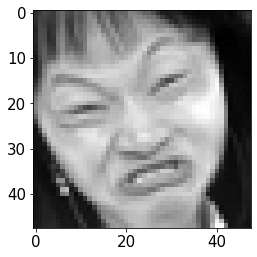

predciton: Angry
actual: Neutral


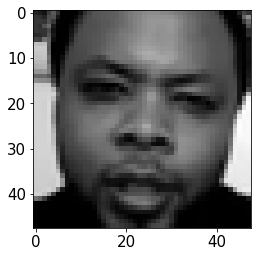

predciton: Neutral
actual: Sad


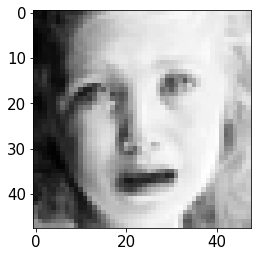

predciton: Neutral
actual: Neutral


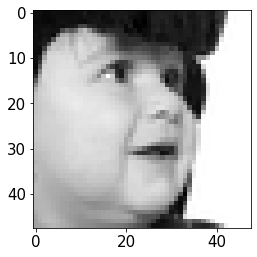

predciton: Neutral
actual: Fear


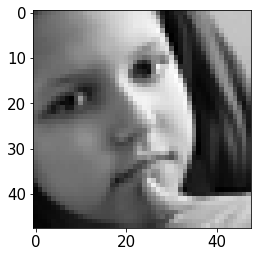

predciton: Angry
actual: Fear


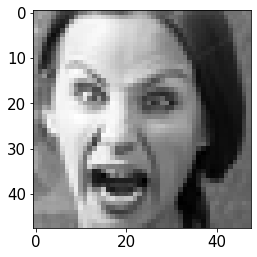

predciton: Sad
actual: Fear


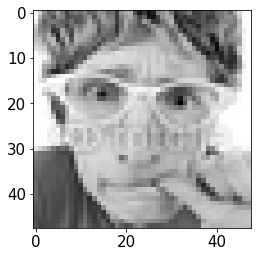

predciton: Sad
actual: Sad


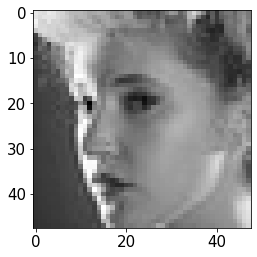

predciton: Neutral
actual: Neutral


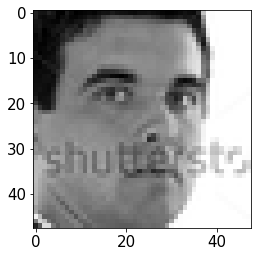

predciton: Sad
actual: Neutral


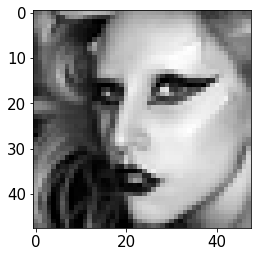

predciton: Neutral
actual: Neutral


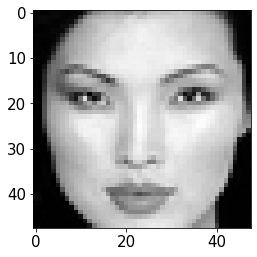

predciton: Fear
actual: Angry


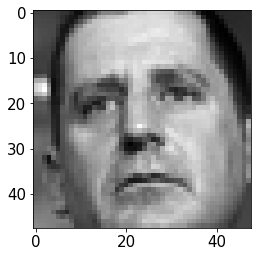

predciton: Happy
actual: Happy


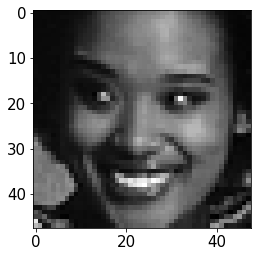

predciton: Happy
actual: Happy


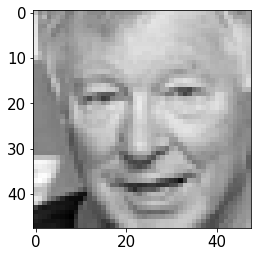

In [ ]:
# Visualize some predictions
test_loader = DataLoader(test_dataset, batch_size=1, shuffle=False, num_workers=4)
emotion_names = ['Angry', 'Disgust', 'Fear', 'Happy', 'Sad', 'Surprise','Neutral']
softmax = nn.Softmax(dim=1)
model.eval()
correct_count = 0
with torch.no_grad():
    for i, data in enumerate(test_loader):
        inputs = data[0].to(device)
        images = inputs
        labels = data[1].to(device)
        rgb_inputs = torch.cat((inputs, inputs, inputs), dim=1)
        inputs = rgb_inputs.float().to(device)
        class_logits= best_model(inputs.float())
        pred_clas = torch.argmax(softmax(class_logits), dim=1)
        if (pred_clas == labels):
            correct_count += 1
        print("predciton:", emotion_names[pred_clas])
        print("actual:", emotion_names[labels])
        plt.imshow(images.view(48, 48).cpu(), cmap='gray')
        plt.show()
        if i == 40:
            break

## Part 3: Putting Everything Together

From part 1, we have the bounding boxes of the face from the image. We then cropped and resized it to a 48x48 grey-scale image that will be fed into the ResNet-based CNN model that we trained in part 2. We're now going to show the end-to-end process of putting these 2 models together and we will do a test with an image that both models haven't seen before.

In [ ]:
import time
import copy
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.optim import lr_scheduler
from torchvision import datasets, models, transforms
from torchvision.utils import save_image
from tqdm.notebook import tqdm
import matplotlib.pyplot as plt
import numpy as np

def load_FER_model(checkpoint_path):
    '''
    Load the emotion recognition model from checkpoint
    '''
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    # load the resnet18 architecture
    model_conv = models.resnet18(pretrained=True)

    # replace the fully-connected layers
    num_ftrs = model_conv.fc.in_features
    model_conv.fc = nn.Sequential(
                nn.Linear(512, 1024),
                nn.ReLU(),
                nn.Linear(1024, 1024),
                nn.ReLU(),
                nn.Linear(1024, 7),
        )
    model_conv = model_conv.to(device)
    model = model_conv
    checkpoint = torch.load(checkpoint_path)
    model.load_state_dict(checkpoint['model_state_dict'])

    return model

def get_prediction(model, inputs):
    '''
    Get the predicted expression in the input image

    Args:
        model: the trained CNN model
        inputs: input image, 48x48 numpy array
    
    Return:
        prediction: predicted emotion name
        scores: softmax scores for each emotion
    '''

    assert inputs.shape == (48, 48), 'input shape is not (48, 48)'
    inputs = torch.tensor(inputs).unsqueeze(0).unsqueeze(0)
    rgb_inputs = torch.cat((inputs, inputs, inputs), dim=1)
    inputs = rgb_inputs.float().to('cuda')
    assert inputs.shape == (1, 3, 48, 48)
    model = model.to('cuda')

    emotion_names = ['Angry', 'Disgust', 'Fear', 'Happy', 'Sad', 'Surprise','Neutral']
    softmax = nn.Softmax(dim=1)
    model.eval()
    # Get prediction
    inputs = inputs.to('cuda')
    class_logits= model(inputs.float())
    scores = softmax(class_logits)
    pred_clas = torch.argmax(scores, dim=1)
    print("prediction:", emotion_names[pred_clas])
    prediction = emotion_names[pred_clas]
    return prediction, scores

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
#localize the face with the model we trained in part 1
os.makedirs("annotated_results", exist_ok=True)

file_path = f'test3.png'
im = cv2.imread(file_path)
outputs = predictor(im)

#visualize the output
visual = Visualizer(im[:, :, ::-1], metadata=statement_metadata, scale=1., instance_mode=ColorMode.IMAGE)
instances = outputs["instances"].to("cpu")
instances.remove('pred_masks')
visual = visual.draw_instance_predictions(instances)
result = visual.get_image()[:, :, ::-1]
file_name = ntpath.basename(clothing_image)
write_res = cv2.imwrite(f'annotated_results/{file_name}', result)

img = cv2.cvtColor(cv2.imread('annotated_results/face_408.jpeg'), cv2.COLOR_BGR2RGB)
plt.imshow(img)
plt.axis('off');

In [ ]:
#### Cropping Detected Faces and Resizing ####

file_name = '/content/test3.png'

bounding_boxes = outputs['instances'].pred_boxes.tensor

image = cv2.imread(file_name,0) # Reading and Converting image to grayscale
image = np.array(image)         # Converting image to np.array


#bl => bottom left
#tr => top right
x_bl = []
y_bl = []

x_tr = []
y_tr = []
for i in range(0,bounding_boxes.shape[0]):
  x_bl.append(int(bounding_boxes[i][0]))
  y_bl.append(int(bounding_boxes[i][1]))

  x_tr.append(int(bounding_boxes[i][2]))
  y_tr.append(int(bounding_boxes[i][3]))

crop_faces = []
for k in range(0,bounding_boxes.shape[0]):
  crop = image[y_bl[k]:y_tr[k],x_bl[k]:x_tr[k]]
  crop = cv2.resize(crop, (48,48))    # Rescale to appropriate size
  crop_faces.append(crop)

crop_faces = np.array(crop_faces)    #crop faces array
print(crop_faces.shape)

(1, 48, 48)


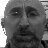

In [ ]:
cv2_imshow(crop_faces[0])

In [ ]:
#double check the type of the image
test_face = crop_faces[0].astype(float)
test_face = (test_face/255 - 0.5)*2
test_face

array([[ 0.99215686,  0.99215686,  0.99215686, ...,  0.52941176,
         0.51372549,  0.48235294],
       [ 0.98431373,  0.98431373,  0.98431373, ..., -0.46666667,
        -0.46666667, -0.52156863],
       [ 0.98431373,  0.97647059,  0.97647059, ...,  0.49019608,
         0.41960784,  0.29411765],
       ...,
       [ 1.        ,  1.        ,  1.        , ..., -0.74117647,
        -0.6627451 , -0.50588235],
       [ 0.94509804,  0.94509804,  0.9372549 , ..., -0.75686275,
        -0.7254902 , -0.63137255],
       [ 0.27843137,  0.2627451 ,  0.25490196, ..., -0.81960784,
        -0.70980392, -0.63137255]])

In [ ]:
# -------------------
# Emotion Prediction
# -------------------

# Load the trained model
checkpoint_path = '/content/drive/Shareddrives/CIS520: Face Detection and Emotion Recognition/models/ResNetCNN_checkpoint'
model = load_FER_model(checkpoint_path)
# Make prediction for a single face
# Use a for loop and call get_prediction to test with multiple faces
prediction, scores = get_prediction(model, test_face)

Downloading: "https://download.pytorch.org/models/resnet18-5c106cde.pth" to /root/.cache/torch/hub/checkpoints/resnet18-5c106cde.pth



prediction: Neutral


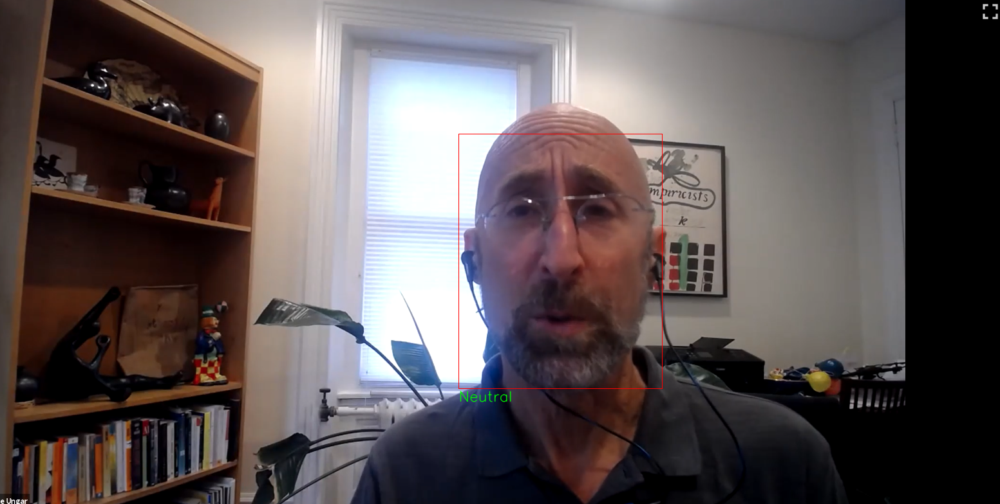

In [ ]:
#### Displaying Image With Emotions ####

emotion_names = ['Angry', 'Disgust', 'Fear', 'Happy', 'Sad', 'Surprise','Neutral']
image = cv2.imread('/content/test3.png')

model_output = scores

emotion_detected = []

for i in range(0,model_output.shape[0]):
  emotion_index = torch.argmax(model_output[i])
  emotion_detected.append(emotion_names[emotion_index])

for k in range(0,model_output.shape[0]):
  top_left = (x_bl[k],y_tr[k])
  bottom_right = (x_tr[k],y_bl[k])
  cv2.rectangle(image,top_left,bottom_right,(0,0,255), 1)
  cv2.putText(image,emotion_detected[k],(x_bl[k],y_tr[k]+20), cv2.FONT_HERSHEY_SIMPLEX, 0.75,(0,255,0),1,cv2.LINE_AA)

  
cv2_imshow(image)

Let's try another example!

In [ ]:
!rm -rf annotated_results

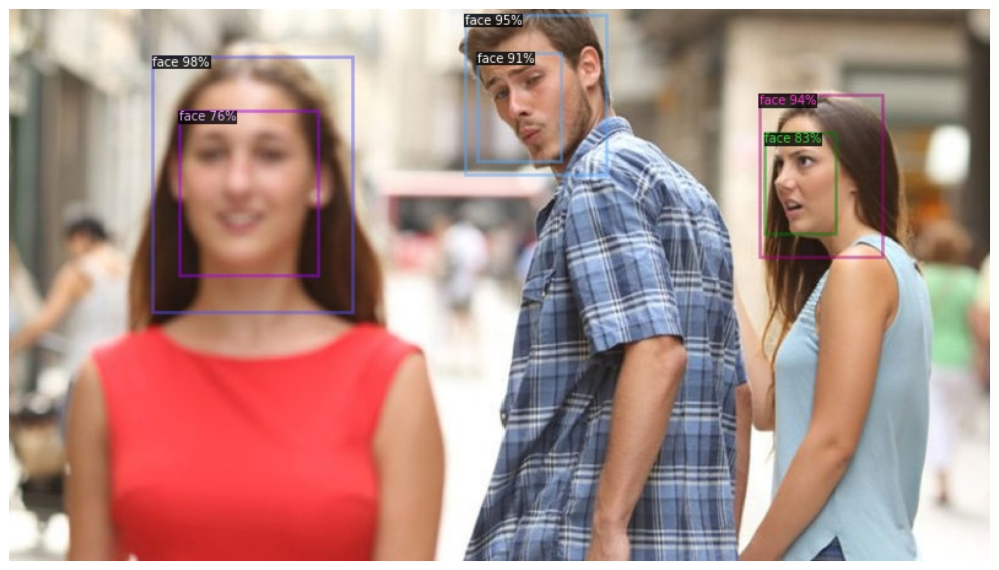

In [ ]:
os.makedirs("annotated_results", exist_ok=True)

file_path = f'test6.png'
im = cv2.imread(file_path)
outputs = predictor(im)

#visualize the output
visual = Visualizer(im[:, :, ::-1], metadata=statement_metadata, scale=1., instance_mode=ColorMode.IMAGE)
instances = outputs["instances"].to("cpu")
instances.remove('pred_masks')
visual = visual.draw_instance_predictions(instances)
result = visual.get_image()[:, :, ::-1]
file_name = ntpath.basename(clothing_image)
write_res = cv2.imwrite(f'annotated_results/{file_name}', result)

img = cv2.cvtColor(cv2.imread('annotated_results/face_408.jpeg'), cv2.COLOR_BGR2RGB)
plt.imshow(img)
plt.axis('off');

In [ ]:
#### Cropping Detected Faces and Resizing ####

bounding_boxes = outputs['instances'].pred_boxes.tensor

image = cv2.imread(file_path,0) # Reading and Converting image to grayscale
image = np.array(image)         # Converting image to np.array


#bl => bottom left
#tr => top right
x_bl = []
y_bl = []

x_tr = []
y_tr = []
for i in range(0,bounding_boxes.shape[0]):
  x_bl.append(int(bounding_boxes[i][0]))
  y_bl.append(int(bounding_boxes[i][1]))

  x_tr.append(int(bounding_boxes[i][2]))
  y_tr.append(int(bounding_boxes[i][3]))

crop_faces = []
for k in range(0,bounding_boxes.shape[0]):
  crop = image[y_bl[k]:y_tr[k],x_bl[k]:x_tr[k]]
  crop = cv2.resize(crop, (48,48))    # Rescale to appropriate size
  crop_faces.append(crop)

crop_faces = np.array(crop_faces)    #crop faces array
print(crop_faces.shape)

(6, 48, 48)


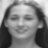

In [ ]:
cv2_imshow(crop_faces[0])

In [ ]:
#get the emotion prediction
scores_list = []
for test_face in crop_faces:
  test_face = (test_face/255 - 0.5)*2
  prediction, scores = get_prediction(model, test_face)
  scores_list.append(scores)

scores_list = np.array(scores_list)

prediction: Happy
prediction: Neutral
prediction: Sad
prediction: Sad
prediction: Sad
prediction: Happy


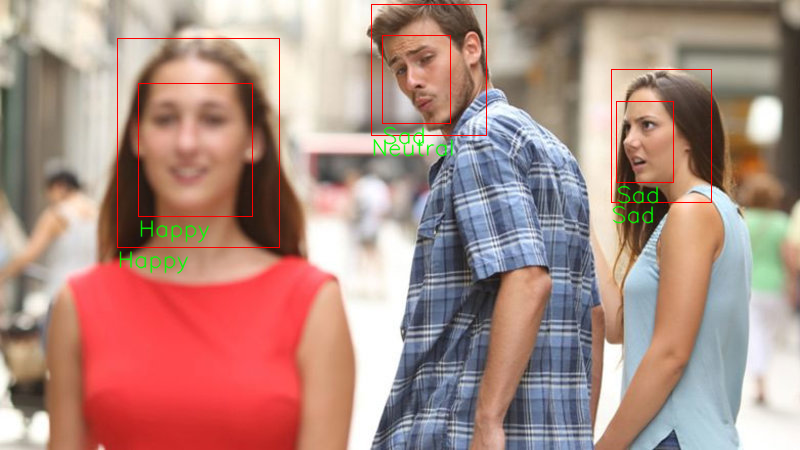

In [ ]:
#### Displaying Image With Emotions ####

emotion_names = ['Angry', 'Disgust', 'Fear', 'Happy', 'Sad', 'Surprise','Neutral']
image = cv2.imread(file_path)

model_output = scores_list

emotion_detected = []

for i in range(0,model_output.shape[0]):
  emotion_index = torch.argmax(model_output[i])
  emotion_detected.append(emotion_names[emotion_index])

for k in range(0,model_output.shape[0]):
  top_left = (x_bl[k],y_tr[k])
  bottom_right = (x_tr[k],y_bl[k])
  cv2.rectangle(image,top_left,bottom_right,(0,0,255), 1)
  cv2.putText(image,emotion_detected[k],(x_bl[k],y_tr[k]+20), cv2.FONT_HERSHEY_SIMPLEX, 0.75,(0,255,0),1,cv2.LINE_AA)

  
cv2_imshow(image)

As you can see, facial expression recognition is a very challenging task, even for a human being. The machine is working hard to learn from us but there is still a long way to go.

And... this is the end of our project! Please feel free to reach out if you have any questions regarding our models.